<a href="https://colab.research.google.com/github/llamb993/Wind_Power_Prediction_Data_Cleaning/blob/main/WindPowerDataCleaning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# importing relavent libraries
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import pandas_profiling

<ipython-input-5-68c298b90349>:7: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling


In [ ]:
#pip install pandas_profiling

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#read in the data and view to 5 rows
#lot's of nan's
df = pd.read_csv(r"Turbine_Data.csv")
df.head()

,Unnamed: 0,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
0,2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
1,2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2,2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
3,2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
4,2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN


In [ ]:
# using descirbe and shape to get a better idea of the full dataset - there looks to be a lot of missing values
# ActivePower has a minimum of -38 - dont think power can be a negative value
# Assuming blade pitching angle can be negative.

print(df.shape)
df.describe()

(118224, 22)


,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
count,94750.000000,93817.000000,62518.000000,41996.000000,41891.000000,41891.000000,62160.0,62540.000000,62438.000000,62295.000000,62427.000000,62449.000000,62406.000000,62507.000000,72278.000000,94748.000000,62127.000000,6.290800e+04,72278.000000,94595.000000
mean,619.109805,28.774654,43.010189,9.749641,10.036535,10.036535,0.0,64.234170,57.561217,1102.026269,72.460403,71.826659,36.897978,39.547603,196.290539,88.133966,9.907500,2.280429e+03,196.290539,5.878960
std,611.275373,4.369145,5.545312,20.644828,20.270465,20.270465,0.0,10.455556,6.323895,528.063946,22.627489,22.650255,5.178711,5.732783,88.296554,116.596725,4.718421,3.586034e+05,88.296554,2.619084
min,-38.524659,0.000000,0.000000,-43.156734,-26.443415,-26.443415,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-203.182591,0.000000,0.000000e+00,0.000000,0.000000
25%,79.642258,25.627428,39.840247,-0.939849,-0.433264,-0.433264,0.0,57.872242,53.942181,1029.812177,55.492241,54.763998,33.943949,35.812500,145.000000,-0.432137,9.231091,2.000000e+00,145.000000,3.823330
50%,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.860720,65.788800,65.004946,37.003815,39.491310,182.000000,35.883659,10.098702,2.000000e+00,182.000000,5.557765
75%,1074.591780,31.664772,47.007976,8.099302,8.480194,8.480194,0.0,71.079306,61.305312,1515.402005,85.867449,85.337740,40.008425,43.359375,271.000000,147.359075,13.600413,2.000000e+00,271.000000,7.506710
max,1779.032433,42.405597,55.088655,90.143610,90.017830,90.017830,0.0,82.237932,70.764581,1809.941700,126.773031,126.043018,47.996185,54.250000,357.000000,403.713620,16.273495,6.574653e+07,357.000000,22.970893


In [ ]:
# next going to take a closer look at null values in each column
# there looks to be a lot of null values.
# Going to explore further and see if these occur at the same time
df.isna().sum()

Unnamed: 0                          0
ActivePower                     23474
AmbientTemperatue               24407
BearingShaftTemperature         55706
Blade1PitchAngle                76228
Blade2PitchAngle                76333
Blade3PitchAngle                76333
ControlBoxTemperature           56064
GearboxBearingTemperature       55684
GearboxOilTemperature           55786
GeneratorRPM                    55929
GeneratorWinding1Temperature    55797
GeneratorWinding2Temperature    55775
HubTemperature                  55818
MainBoxTemperature              55717
NacellePosition                 45946
ReactivePower                   23476
RotorRPM                        56097
TurbineStatus                   55316
WTG                                 0
WindDirection                   45946
WindSpeed                       23629
dtype: int64

In [ ]:
# first I'm going to set Unnamed: 0 as the index and rename and turn to datetime objects
df = df.rename(columns={'Unnamed: 0': 'Time'})
df.index = pd.to_datetime(df['Time'])
df.drop(['Time'],axis=1,inplace=True)
df.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
Time,,,,,,,,,,,,,,,,,,,,,
2017-12-31 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:10:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:20:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:30:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN
2017-12-31 00:40:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,G01,NaN,NaN


In [ ]:
# using andas profiler to get a more detailed break down of each variable
pandas_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# I can see there are 22734 rows which all the vales are nan and WTG is G01.
# WTG will be removed as it contains no unique values so will not be help full in model building
# Im also going to remove ControlBoxTemperature as it also has no unique values
df.drop(['WTG','ControlBoxTemperature'],axis=1,inplace=True)

In [ ]:
# now I am going to see how many rows contain all nulls
df.shape[0] - df.dropna(how='all').shape[0]

22734

In [ ]:
# there are 118224 rows so removing 22734 will leave 95490 rows which is still a significant amount fo data
# these rows will also be of no use to us
df = df.dropna(how='all')
df.shape

(95490, 19)

In [ ]:
# Im going inspect nulls again
df.isna().sum()

ActivePower                       740
AmbientTemperatue                1673
BearingShaftTemperature         32972
Blade1PitchAngle                53494
Blade2PitchAngle                53599
Blade3PitchAngle                53599
GearboxBearingTemperature       32950
GearboxOilTemperature           33052
GeneratorRPM                    33195
GeneratorWinding1Temperature    33063
GeneratorWinding2Temperature    33041
HubTemperature                  33084
MainBoxTemperature              32983
NacellePosition                 23212
ReactivePower                     742
RotorRPM                        33363
TurbineStatus                   32582
WindDirection                   23212
WindSpeed                         895
dtype: int64

In [ ]:
# there is still a signifcant amount of data missing
# drop null values
df = df.dropna()
df.shape

(32818, 19)

In [ ]:
df.isna().sum()

ActivePower                     0
AmbientTemperatue               0
BearingShaftTemperature         0
Blade1PitchAngle                0
Blade2PitchAngle                0
Blade3PitchAngle                0
GearboxBearingTemperature       0
GearboxOilTemperature           0
GeneratorRPM                    0
GeneratorWinding1Temperature    0
GeneratorWinding2Temperature    0
HubTemperature                  0
MainBoxTemperature              0
NacellePosition                 0
ReactivePower                   0
RotorRPM                        0
TurbineStatus                   0
WindDirection                   0
WindSpeed                       0
dtype: int64

In [ ]:
# next I'm going to remove power values below 0
df =  df[df['ActivePower']>=0]
df.shape

(27465, 19)

Text(0, 0.5, 'Active Power')

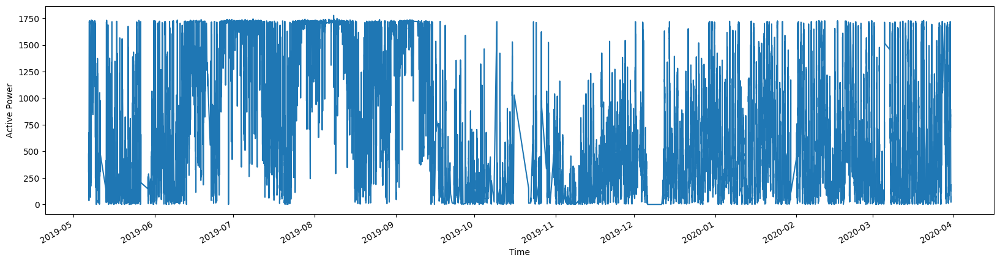

In [ ]:
# as the data is time series data I'd also like to plot the variables over time
df['ActivePower'].plot(figsize=(20,5))
plt.xlabel('Time')
plt.ylabel('Active Power')

Text(0, 0.5, 'Active Power')

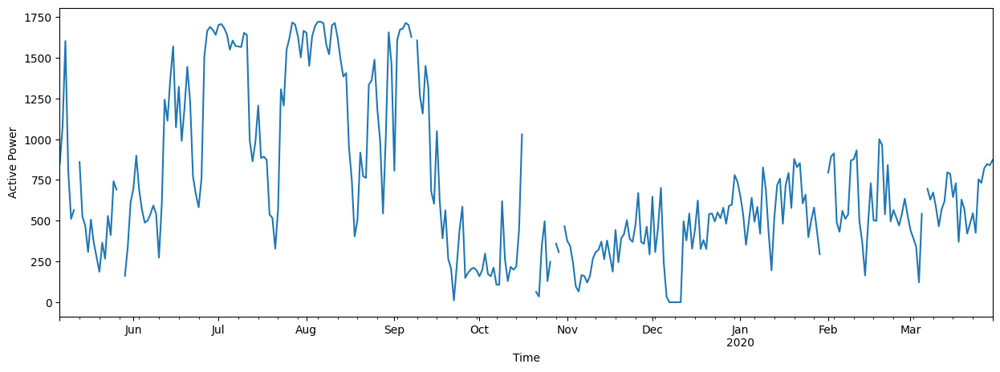

In [ ]:
# to see values better the average over day was plot as well
df['ActivePower'].resample('D').mean().plot(figsize=(15,5))
plt.xlabel('Time')
plt.ylabel('Active Power')

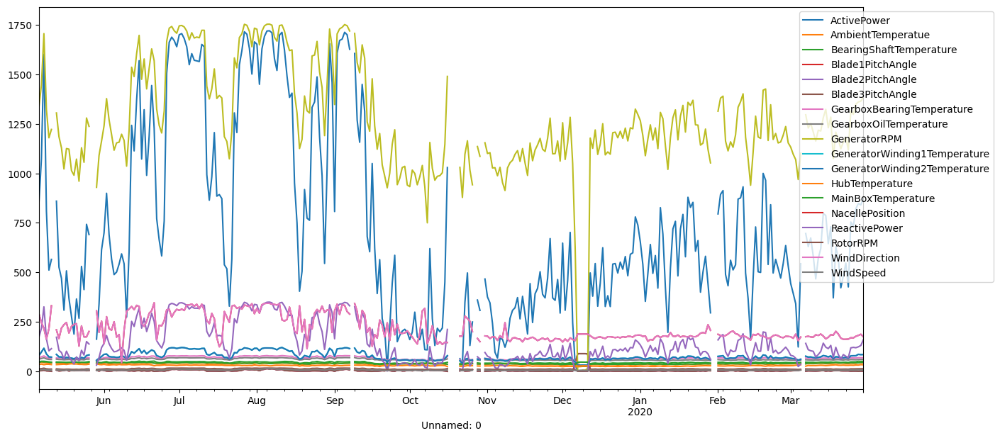

In [ ]:
# due to the different scales it is very hard to see all the variables on one graph
# I will remove this ans plot seperately
#df2 = df.drop(['TurbineStatus'],axis=1)
df2.resample('D').mean().plot(figsize=(15,7))
plt.legend(loc='upper center', bbox_to_anchor=(1.04, 1))

In [ ]:
# scale values
#from sklearn.preprocessing import MinMaxScaler
# define scaler
scaler = MinMaxScaler()
#fit and trasnform scaler on training set
scaled_data = scaler.fit_transform(df)
# tranform back to df for plotting
scaled_data = pd.DataFrame(scaled_data, index=df.index, columns=df.columns)
scaled_data

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
Time,,,,,,,,,,,,,,,,,,,
2019-05-06 17:50:00+00:00,0.266755,0.768911,0.833532,0.051309,0.046009,0.046009,0.746788,0.672585,0.650391,0.456567,0.453784,0.953920,0.943014,0.733193,0.523029,0.649178,3.041986e-08,0.733193,0.211980
2019-05-06 18:00:00+00:00,0.331581,0.750499,0.843902,0.010461,0.004917,0.004917,0.805611,0.711448,0.689742,0.491273,0.488553,0.958330,0.891454,0.689076,0.569192,0.692286,3.041986e-08,0.689076,0.206684
2019-05-06 18:10:00+00:00,0.168058,0.725997,0.846788,0.014653,0.007603,0.007603,0.800179,0.727483,0.583553,0.503817,0.500445,0.958330,0.870118,0.651261,0.464895,0.584435,3.041986e-08,0.651261,0.166228
2019-05-06 18:20:00+00:00,0.295120,0.723007,0.847956,0.009962,0.005045,0.005045,0.814625,0.739547,0.653266,0.514622,0.510820,0.958330,0.859418,0.683473,0.542293,0.653562,3.041986e-08,0.683473,0.212160
2019-05-06 18:30:00+00:00,0.377959,0.730576,0.856765,0.008910,0.004151,0.004151,0.848325,0.766726,0.734768,0.539485,0.536718,0.958330,0.853445,0.697479,0.597611,0.736032,3.041986e-08,0.697479,0.243518
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-03-30 23:10:00+00:00,0.039372,0.367905,0.829774,0.038204,0.032162,0.032162,0.727416,0.645836,0.574174,0.465875,0.461341,0.812751,0.680454,0.498599,0.382955,0.574587,3.041986e-08,0.498599,0.093934
2020-03-30 23:20:00+00:00,0.022953,0.371406,0.827731,0.040261,0.034242,0.034242,0.719158,0.636846,0.574335,0.461076,0.456593,0.812705,0.677685,0.498599,0.372917,0.574299,3.041986e-08,0.498599,0.081245
2020-03-30 23:30:00+00:00,0.011679,0.369550,0.825252,0.040299,0.034275,0.034275,0.710614,0.627337,0.574323,0.457779,0.453015,0.812644,0.674025,0.498599,0.366328,0.574762,3.041986e-08,0.498599,0.084536


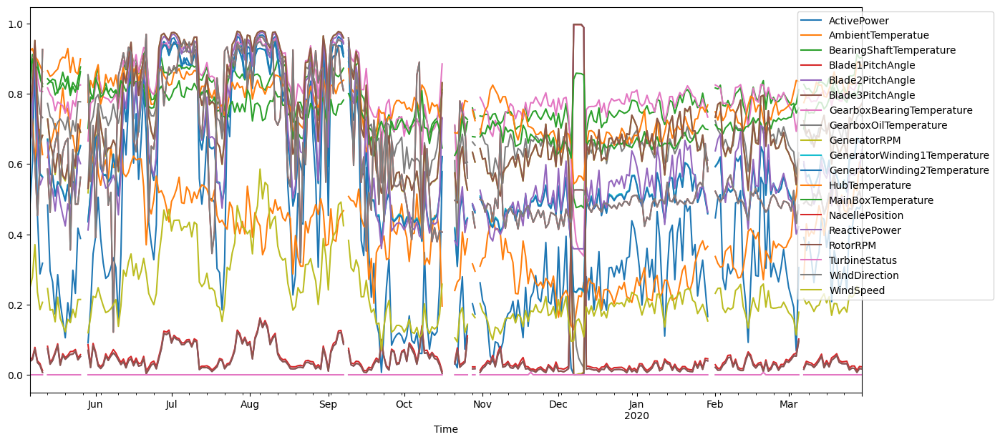

In [ ]:
# the below plot shows all variables. It looks like there are significant patterns
scaled_data.resample('D').mean().plot(figsize=(15,7))
plt.legend(loc='upper center', bbox_to_anchor=(1.04, 1))

In [ ]:
# test train split for model building
# then scaling training and applying to testing

from sklearn.model_selection import train_test_split
# set features and targets
targetName="ActivePower"
featureNames=df.columns[df.columns != targetName]
X = df[featureNames]
y = df[targetName]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# define scaler
scaler = MinMaxScaler()
#fit and trasnform scaler on training set
#X_train = scaler.fit_transform(X_train.loc[:, X_train.columns != 'Unnamed: 0'])
X_train2 = scaler.fit_transform(X_train)
X_train2

array([[2.43662430e-01, 7.65773339e-01, 8.89689668e-03, ...,
        3.04198573e-08, 4.81792717e-01, 2.58466548e-01],
       [2.89960873e-01, 7.71709679e-01, 3.97200787e-02, ...,
        3.04198573e-08, 6.38655462e-01, 7.13910600e-02],
       [4.52516514e-01, 7.88422864e-01, 5.22079082e-02, ...,
        3.04198573e-08, 9.83193277e-01, 3.43010694e-01],
       ...,
       [8.51740675e-01, 8.80750980e-01, 7.44347213e-03, ...,
        3.04198573e-08, 5.26610644e-01, 2.04226736e-01],
       [4.13427752e-01, 7.10985690e-01, 2.85825314e-02, ...,
        3.04198573e-08, 4.60784314e-01, 1.01936057e-01],
       [2.30000766e-01, 8.12713493e-01, 9.11744928e-03, ...,
        3.04198573e-08, 5.07402961e-01, 2.20140673e-01]])

In [ ]:
#scaled_data = pd.DataFrame(scaled_data, index=df.index, columns=df.columns)
X_train3 = pd.DataFrame(X_train2, index=X_train.index, columns=X_train.columns)
X_train3

,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
Time,,,,,,,,,,,,,,,,,,
2019-12-16 10:30:00+00:00,0.243662,0.765773,0.008897,0.003674,0.003674,0.846234,0.712338,0.794420,0.587422,0.585981,0.707681,0.688412,0.481793,0.695982,0.795035,3.041986e-08,0.481793,0.258467
2020-02-15 23:50:00+00:00,0.289961,0.771710,0.039720,0.035719,0.035719,0.703844,0.609084,0.574200,0.437972,0.434100,0.750139,0.636725,0.638655,0.370561,0.574602,3.041986e-08,0.638655,0.071391
2019-05-25 02:20:00+00:00,0.452517,0.788423,0.052208,0.046981,0.046981,0.839529,0.904077,0.970663,0.827435,0.828627,0.714416,0.676509,0.983193,0.965750,0.971227,3.041986e-08,0.983193,0.343011
2019-05-14 22:40:00+00:00,0.587992,0.747646,0.025031,0.020916,0.020916,0.668139,0.663050,0.574403,0.485341,0.481115,0.796011,0.704187,0.784314,0.413916,0.575005,3.041986e-08,0.784314,0.116812
2019-12-26 14:10:00+00:00,0.279524,0.733821,0.009038,0.004134,0.004134,0.815513,0.678125,0.751437,0.522821,0.519732,0.729180,0.690256,0.490196,0.627767,0.751571,3.041986e-08,0.490196,0.247703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-05 09:20:00+00:00,0.555064,0.723981,0.111642,0.107100,0.107100,0.744263,0.632457,0.447157,0.460217,0.456891,0.729145,0.774415,0.462885,0.392238,0.448123,3.041986e-08,0.462885,0.115334
2019-07-18 04:20:00+00:00,0.454249,0.877118,0.023846,0.013795,0.013795,0.924578,0.846146,0.891287,0.711412,0.712310,0.791655,0.792972,0.022409,0.839986,0.892250,3.041986e-08,0.022409,0.284583
2019-05-19 15:10:00+00:00,0.851741,0.880751,0.007443,0.003505,0.003505,0.814800,0.728451,0.636156,0.591331,0.587918,0.979324,0.893219,0.526611,0.513946,0.636756,3.041986e-08,0.526611,0.204227


In [ ]:
X_test2 = scaler.transform(X_test.loc[:, X_test.columns != 'Unnamed: 0'])
X_test3 = pd.DataFrame(X_test2, index=X_test.index, columns=X_test.columns)
X_test3

,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
Time,,,,,,,,,,,,,,,,,,
2019-07-24 00:20:00+00:00,0.277328,0.901073,0.008681,0.004953,0.004953,0.950897,0.899095,0.901192,0.851314,0.852362,0.791810,0.726466,0.966387,0.836206,0.901486,3.041986e-08,0.966387,0.337405
2020-02-08 15:50:00+00:00,0.341679,0.876118,0.010360,0.005099,0.005099,0.894185,0.802109,0.908421,0.830167,0.831038,0.812485,0.748704,0.518207,0.835144,0.909212,3.041986e-08,0.518207,0.277884
2019-06-24 09:00:00+00:00,0.637863,0.771569,0.022267,0.016329,0.016329,0.773228,0.713223,0.586054,0.468071,0.465578,0.770940,0.849381,0.957983,0.435027,0.586742,3.041986e-08,0.957983,0.124377
2020-02-19 21:10:00+00:00,0.161004,0.907527,0.041477,0.031987,0.031987,0.886263,0.771861,0.965403,0.853995,0.855223,0.771024,0.669964,0.509804,0.954208,0.966821,3.041986e-08,0.509804,0.325945
2020-03-28 18:10:00+00:00,0.514519,0.909560,0.008972,0.004096,0.004096,0.793880,0.658293,0.728764,0.615980,0.613463,0.895984,0.784263,0.464986,0.602205,0.729283,3.041986e-08,0.464986,0.224866
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-11-17 10:00:00+00:00,0.502854,0.722191,0.041127,0.031456,0.031456,0.711499,0.612420,0.574341,0.455209,0.450732,0.770815,0.764084,0.414566,0.371723,0.574346,3.041986e-08,0.414566,0.071283
2019-08-06 12:50:00+00:00,0.438715,0.854399,0.163553,0.158811,0.158811,0.982848,0.956874,0.977424,0.956851,0.956654,0.875155,0.795137,0.983193,0.973956,0.978177,3.041986e-08,0.983193,0.563994
2019-07-27 18:30:00+00:00,0.353405,0.894135,0.065058,0.059349,0.059349,0.964831,0.917049,0.972457,0.918557,0.918917,0.875117,0.767857,0.929972,0.968574,0.974443,3.041986e-08,0.929972,0.369161


In [ ]:
X_test3.to_csv('/content/drive/My Drive/WindPowerX_test.csv')
X_train3.to_csv('/content/drive/My Drive/WindPowerX_train.csv')
y_train.to_csv('/content/drive/My Drive/WindPowery_train.csv')
y_test.to_csv('/content/drive/My Drive/WindPowery_test.csv')